In [2]:
using Plots; gr(); 
using Statistics
using DelimitedFiles
using StatGeochem

include("../src/utilities.jl")
include("../src/bin.jl")
include("../src/invertData.jl")
include("../src/crustDistribution.jl")

Main.crustDistribution

In [3]:
layer = "upper"
dset="Crust1.0"

"Crust1.0"

In [4]:
test_dat, test_header = readdlm("../data/remote/base/perplex_fizz/results-$(layer).csv",
    ',', header=true)
dat, header = readdlm("../data/remote/base/small_seismic_uncertainty/results-$(layer).csv",
    ',', header=true)

header = header[:]
test_header = test_header[:];

In [5]:
si_i = findfirst(isequal("SiO2"), header)
lat_i = findfirst(isequal("sample_lat"), header)
long_i = findfirst(isequal("sample_long"), header);
geo_i = findfirst(isequal("sample_geotherm"), header);
bin_i = findfirst(isequal("bin"), header);

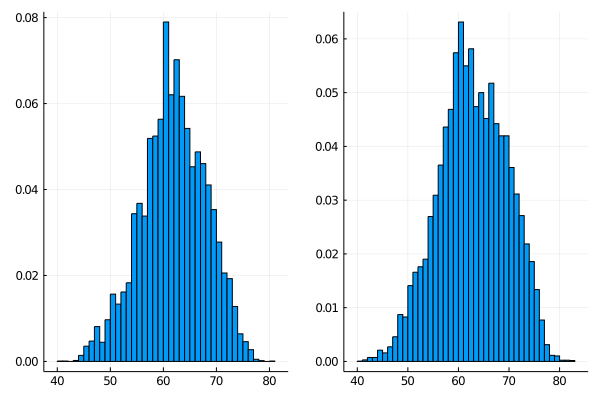

In [6]:
h1 = histogram(dat[:,si_i], legend=false, normalize=:pdf)
h2 = histogram(test_dat[:,si_i], legend=false, normalize=:pdf)
plot(h1, h2)

In [10]:
g_binned = globe(areaAverage(Float64.(dat[:,lat_i]), Float64.(dat[:,long_i]), 
        Float64.(dat[:,si_i]))...);
g_nobin = globe(areaAverage(Float64.(test_dat[:,lat_i]), Float64.(test_dat[:,long_i]),
        Float64.(test_dat[:,si_i]))...);
g_vp = globe(areaAverage(Float64.(dat[:,lat_i]), Float64.(dat[:,long_i]),
        Float64.(dat[:,findfirst(isequal("sample_vp"), header)]))...);
g_bin = globe(areaAverage(Float64.(dat[:,lat_i]), Float64.(dat[:,long_i]),
        Float64.(dat[:,bin_i]))...);

In [11]:
if size(g_nobin) != size(g_binned)
    println("sizes $(size(g_nobin)), $(size(g_bin))")
    new_size = (max(size(g_binned,1), size(g_nobin,1)), max(size(g_binned,2), size(g_nobin,2)))
    println("new size $(new_size)")

    new = fill(NaN, new_size)
    new[1:size(g_binned,1), 1:size(g_binned,2)] = g_binned
    g_binned = new

    new2 = fill(NaN, new_size)
    new2[1:size(g_bin,1), 1:size(g_bin,2)] = g_bin
    g_bin=new2

    new3 = fill(NaN, new_size)
    new3[1:size(g_vp,1), 1:size(g_vp,2)] = g_vp
    g_vp=new3

    new4 = fill(NaN, new_size)
    new4[1:size(g_nobin,1), 1:size(g_nobin,2)] = g_nobin
    g_nobin = new4

end

println("sizes $(size(g_nobin)), $(size(g_bin))")

sizes (175, 361), (175, 362)
new size (175, 362)
sizes (175, 362), (175, 362)


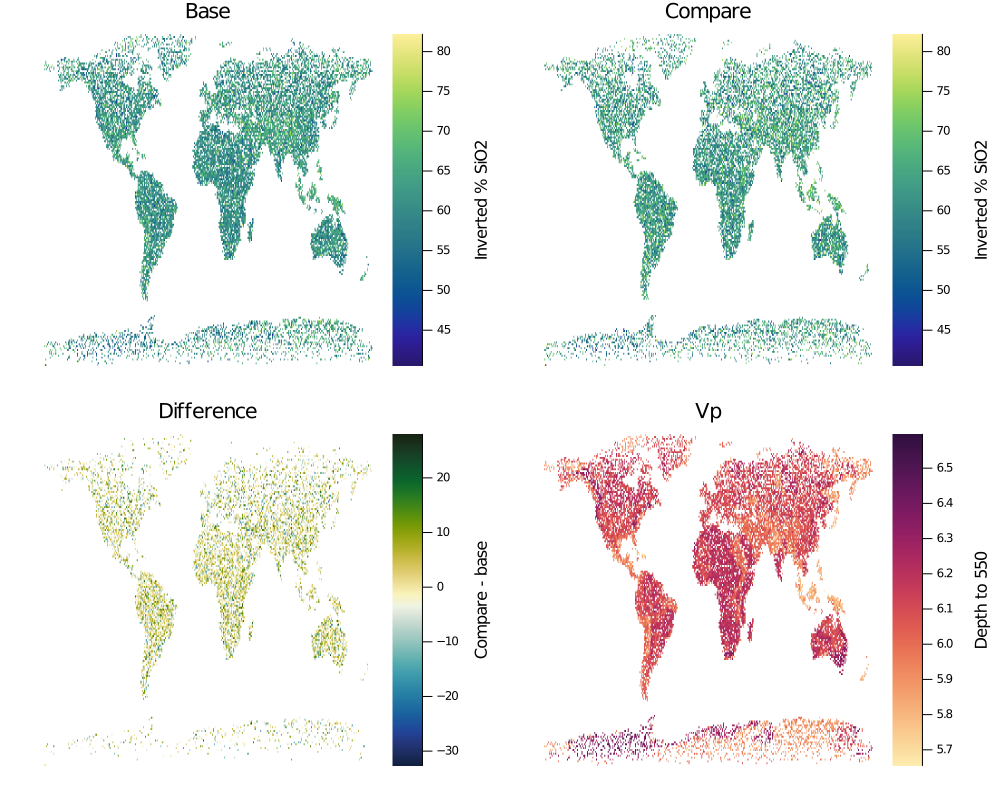

In [12]:
most_felsic = max(maximum(g_binned[.!isnan.(g_binned)]), maximum(g_nobin[.!isnan.(g_nobin)]))
most_mafic = min(minimum(g_binned[.!isnan.(g_binned)]), minimum(g_nobin[.!isnan.(g_nobin)]))

g_binned[1,1] = most_felsic; g_nobin[1,1] = most_felsic
g_binned[1,2] = most_mafic; g_nobin[1,2] = most_mafic # so they're on the same colorbar scale

h1 = heatmap(g_binned, grid=false, axis=false, title="Base", colorbar_title="Inverted % SiO2", c=:haline);
h2 = heatmap(g_nobin, grid=false, axis=false, title="Compare", colorbar_title="Inverted % SiO2", c=:haline);
h3 = heatmap(g_nobin-g_binned, grid=false, axis=false, title="Difference", 
    colorbar_title="Compare - base", c=:delta);
h4 = heatmap(g_vp, grid=false, axis=false, title="Vp", 
    colorbar_title="Depth to 550", c=:matter);
p = plot(h1, h2, h3, h4, layout=(2,2), size=(1000,800))

In [9]:
difference=g_nobin-g_binned

println(size(difference))
println(size(g_geotherm))
x, y, yer = bin(reshape(g_geotherm, (1,length(g_geotherm))) , 
    reshape(difference, (1,length(difference))),
    minimum(g_geotherm[.!isnan.(g_geotherm)]), maximum(g_geotherm[.!isnan.(g_geotherm)]), 10)

(174, 362)
(174, 362)


(5.687975536035384:0.15263359459967607:7.061677887432468, [-10.431494999999996, -5.989283713333334, -5.573690419622611, -4.0448685582588295, -2.921508793430513, -1.7411416766347312, 0.042903346735279464, 2.8391211339806097, 3.616745189393939, 4.198143749999999], [4.620310309588903, 0.9055955243731895, 0.4005758876214187, 0.16418745035281834, 0.08811376808512507, 0.07614054333929336, 0.11503303693547427, 0.27120972931873333, 0.7742394391054913, 3.2453748667368307])

In [10]:
difference=g_nobin-g_binned
p1 = plot(reshape(g_geotherm, (1,length(g_geotherm)))[:] , reshape(difference, (1,length(g_geotherm)))[:],
    legend=false, xlabel="Geotherm (depth to 550)", ylabel="Difference no bin - bin (% SiO2)",
    markersize=.3, markerstrokewidth=0, 
    seriestype=:scatter);#, marker_z=reshape(g_nobin, (1, length(g_geotherm)))[:], c=:haline); 
plot!(p1, x, y, yerror=yer)
scatter!(p1, [maximum(x)-5,maximum(x)-5],[3,-10], markersize=0, series_annotations = text.(["More mafic with binning", "More felsic with binning"], :bottom))
hline!(p1, [0])

In [11]:
all = plot(p, p1, layout=grid(2, 1, heights=[0.7 ,0.3]), size=(1200,1200))

In [12]:
savefig(all, "../output/$(layer)_crust_binning_maps_$(dset).png")

In [13]:
((rho, vp, vpvs, geotherms), (crustbase, ages, lats, longs)) = getAllSeismic(6, resample=false, latlong=true);

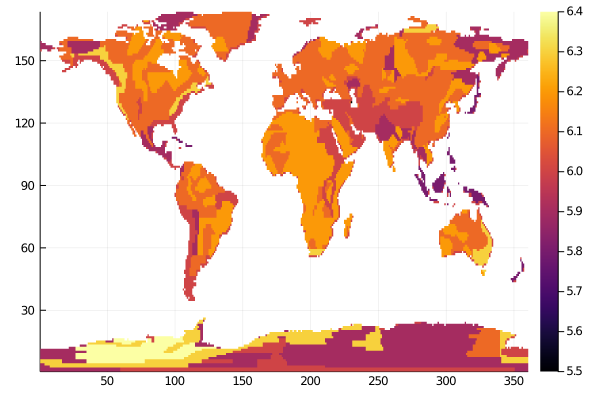

In [17]:
heatmap(globe(lats, longs, vp))

In [15]:
scatter(vp, vpvs, alpha=.1)

In [58]:
nanmean(g_nobin)

64.56032197826107

In [59]:
nanmean(Float64.(dat[:, si_i]))

64.54163863987355

In [66]:
sum([1, 2, 3])

6

In [108]:
size(test_dat)

(20000, 131)

In [109]:
length(unique(test_dat[:,si_i]))

8501

In [98]:
sum(isnan.(dat[:,si_i]))

6900

In [91]:
same = dat[dat[:,si_i] .== dat[101,si_i], :]
size(same)
println(header)

AbstractString["sample_rho", "sample_vp", "sample_vpvs", "sample_geotherm", "sample_age", "sample_depth", "sample_lat", "sample_long", "index", "SiO2", "TiO2", "Al2O3", "FeO", "MgO", "CaO", "Na2O", "K2O", "H2O_Total", "CO2", "MnO", "P2O5", "Li", "Be", "B", "F", "S", "Cl", "Sc", "V", "Cr", "Co", "Ni", "Cu", "Zn", "Ga", "As", "Se", "Rb", "Sr", "Y", "Zr", "Nb", "Mo", "Pd", "La", "Ce", "Pr", "Nd", "Sm", "Eu", "Gd", "Tb", "Dy", "Ho", "Er", "Tm", "Yb", "Lu", "Latitude", "Longitude", "Age", "geotherm", "upper", "middle", "lower", "exhumed", "bin", "index error", "SiO2 error", "TiO2 error", "Al2O3 error", "FeO error", "MgO error", "CaO error", "Na2O error", "K2O error", "H2O_Total error", "CO2 error", "MnO error", "P2O5 error", "Li error", "Be error", "B error", "F error", "S error", "Cl error", "Sc error", "V error", "Cr error", "Co error", "Ni error", "Cu error", "Zn error", "Ga error", "As error", "Se error", "Rb error", "Sr error", "Y error", "Zr error", "Nb error", "Mo error", "Pd error",

In [97]:
scatter(dat[:,1], dat[:,2], dat[:,3], markersize=2, markeralpha=.1)

0.02666666666666667